# **EDA on Cardiographic dataset**

## **1.Data Cleaning and Preparation**

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

plt.rcParams['figure.figsize']=(10,5)
plt.rcParams['figure.dpi']=300

import warnings
warnings.filterwarnings("ignore")


In [15]:
df=pd.read_csv("/content/Cardiotocographic.csv")
df

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,MLTV,Width,Tendency,NSP
0,120.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,73.0,0.5,43.000000,2.4,64.0,0.999926,2.000000
1,132.000000,0.006380,0.000000,0.006380,0.003190,0.0,0.0,17.0,2.1,0.000000,10.4,130.0,0.000000,1.000000
2,133.000000,0.003322,0.000000,0.008306,0.003322,0.0,0.0,16.0,2.1,0.000000,13.4,130.0,0.000000,1.000000
3,134.000000,0.002561,0.000000,0.007742,0.002561,0.0,0.0,16.0,2.4,0.000000,23.0,117.0,1.000000,1.000000
4,131.948232,0.006515,0.000000,0.008143,0.000000,0.0,0.0,16.0,2.4,0.000000,19.9,117.0,1.000000,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2121,140.000000,0.000000,0.961268,0.007426,0.000000,0.0,0.0,79.0,0.2,25.000000,7.2,40.0,0.000000,2.000000
2122,140.000000,0.000775,0.000000,0.006979,0.000000,0.0,0.0,78.0,0.4,22.000000,7.1,66.0,1.000000,2.000000
2123,140.000000,0.000980,0.000000,0.006863,0.000000,0.0,0.0,79.0,0.4,20.000000,6.1,67.0,1.000000,1.990464
2124,140.000000,0.000679,0.000000,0.006110,0.000000,0.0,0.0,78.0,0.4,27.000000,7.0,66.0,1.000000,2.000000


In [16]:
df.head()

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,MLTV,Width,Tendency,NSP
0,120.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,73.0,0.5,43.0,2.4,64.0,0.999926,2.0
1,132.000000,0.006380,0.0,0.006380,0.003190,0.0,0.0,17.0,2.1,0.0,10.4,130.0,0.000000,1.0
2,133.000000,0.003322,0.0,0.008306,0.003322,0.0,0.0,16.0,2.1,0.0,13.4,130.0,0.000000,1.0
3,134.000000,0.002561,0.0,0.007742,0.002561,0.0,0.0,16.0,2.4,0.0,23.0,117.0,1.000000,1.0
4,131.948232,0.006515,0.0,0.008143,0.000000,0.0,0.0,16.0,2.4,0.0,19.9,117.0,1.000000,1.0


In [17]:
df.tail()

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,MLTV,Width,Tendency,NSP
2121,140.0,0.000000,0.961268,0.007426,0.0,0.0,0.0,79.0,0.2,25.000000,7.2,40.0,0.0,2.000000
2122,140.0,0.000775,0.000000,0.006979,0.0,0.0,0.0,78.0,0.4,22.000000,7.1,66.0,1.0,2.000000
2123,140.0,0.000980,0.000000,0.006863,0.0,0.0,0.0,79.0,0.4,20.000000,6.1,67.0,1.0,1.990464
2124,140.0,0.000679,0.000000,0.006110,0.0,0.0,0.0,78.0,0.4,27.000000,7.0,66.0,1.0,2.000000
2125,142.0,0.001616,-0.000188,0.008078,0.0,0.0,0.0,74.0,0.4,35.857183,5.0,42.0,0.0,1.000000


In [18]:
df.describe()
# there are 2126 rows and 14 columns in the dataset
#but some of the columns are having missing values such as:
# LB, AC, DS, DP, MLTV, Width, Tendency, NSP

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,MLTV,Width,Tendency,NSP
count,2105.000000,2106.000000,2126.000000,2126.000000,2126.000000,2105.000000,2105.000000,2126.000000,2126.000000,2126.000000,2105.000000,2105.000000,2105.000000,2105.000000
mean,133.343598,0.003219,0.009894,0.004391,0.001895,0.000003,0.000175,46.995984,1.364378,10.285964,8.284887,70.429260,0.316371,1.304507
std,11.270154,0.004391,0.067540,0.003340,0.003343,0.000142,0.000840,18.813973,1.173632,21.205041,7.772858,42.931822,0.645622,0.644619
min,51.842487,-0.019284,-0.480634,-0.014925,-0.015393,-0.001353,-0.005348,-63.000000,-6.600000,-91.000000,-50.700000,-174.000000,-3.000000,-1.025988
25%,126.000000,0.000000,0.000000,0.001851,0.000000,0.000000,0.000000,32.000000,0.700000,0.000000,4.600000,37.000000,0.000000,1.000000
50%,133.000000,0.001634,0.000000,0.004484,0.000000,0.000000,0.000000,49.000000,1.200000,0.000000,7.400000,67.000000,0.000000,1.000000
75%,140.000000,0.005650,0.002567,0.006536,0.003289,0.000000,0.000000,61.000000,1.700000,11.000000,10.900000,100.000000,1.000000,1.000000
max,214.000000,0.038567,0.961268,0.030002,0.030769,0.002706,0.010695,162.000000,13.800000,182.000000,101.400000,357.000000,3.000000,5.000000


In [19]:
df.info()
# to check the datatypes of the columns

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2126 entries, 0 to 2125
Data columns (total 14 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   LB        2105 non-null   float64
 1   AC        2106 non-null   float64
 2   FM        2126 non-null   float64
 3   UC        2126 non-null   float64
 4   DL        2126 non-null   float64
 5   DS        2105 non-null   float64
 6   DP        2105 non-null   float64
 7   ASTV      2126 non-null   float64
 8   MSTV      2126 non-null   float64
 9   ALTV      2126 non-null   float64
 10  MLTV      2105 non-null   float64
 11  Width     2105 non-null   float64
 12  Tendency  2105 non-null   float64
 13  NSP       2105 non-null   float64
dtypes: float64(14)
memory usage: 232.7 KB


In [20]:
df.duplicated()
# to check the duplicated values

,0
0,False
1,False
2,False
3,False
4,False
...,...
2121,False
2122,False
2123,False
2124,False


In [21]:
df.duplicated().sum()

2

In [22]:
df[df.duplicated()]
#print the duplicated values

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,MLTV,Width,Tendency,NSP
1115,122.0,0.000000,0.0,0.000000,0.0,0.0,0.0,19.0,1.9,0.0,15.1,39.0,0.0,1.0
1458,148.0,0.004717,0.0,0.002358,0.0,0.0,0.0,40.0,0.9,0.0,10.6,35.0,0.0,1.0


In [23]:
df[df.duplicated(keep=False)]

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,MLTV,Width,Tendency,NSP
1113,122.0,0.000000,0.0,0.000000,0.0,0.0,0.0,19.0,1.9,0.0,15.1,39.0,0.0,1.0
1115,122.0,0.000000,0.0,0.000000,0.0,0.0,0.0,19.0,1.9,0.0,15.1,39.0,0.0,1.0
1457,148.0,0.004717,0.0,0.002358,0.0,0.0,0.0,40.0,0.9,0.0,10.6,35.0,0.0,1.0
1458,148.0,0.004717,0.0,0.002358,0.0,0.0,0.0,40.0,0.9,0.0,10.6,35.0,0.0,1.0


In [24]:
df.drop_duplicates(inplace=True)
df.shape

(2124, 14)

In [25]:
df.duplicated().sum()

0

In [26]:
df.isna()#to check the missing values

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,MLTV,Width,Tendency,NSP
0,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2121,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2122,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2123,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2124,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [27]:
df.isna().sum()

,0
LB,21
AC,20
FM,0
UC,0
DL,0
DS,21
DP,21
ASTV,0
MSTV,0
ALTV,0


<Axes: >

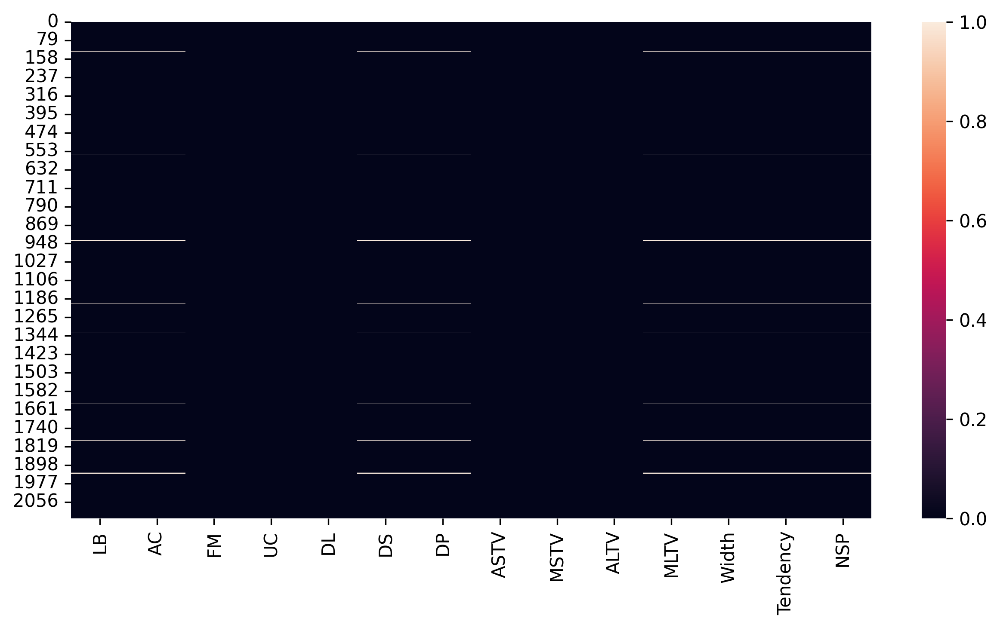

In [28]:
sns.heatmap(df.isna())
# visualizing missing values

In [29]:
len(df)

2124

In [31]:

#% of missing ValuesView

for i in df.isna().sum():
  print((i/len(df))*100)

0.9887005649717515
0.9416195856873822
0.0
0.0
0.0
0.9887005649717515
0.9887005649717515
0.0
0.0
0.0
0.9887005649717515
0.9887005649717515
0.9887005649717515
0.9887005649717515


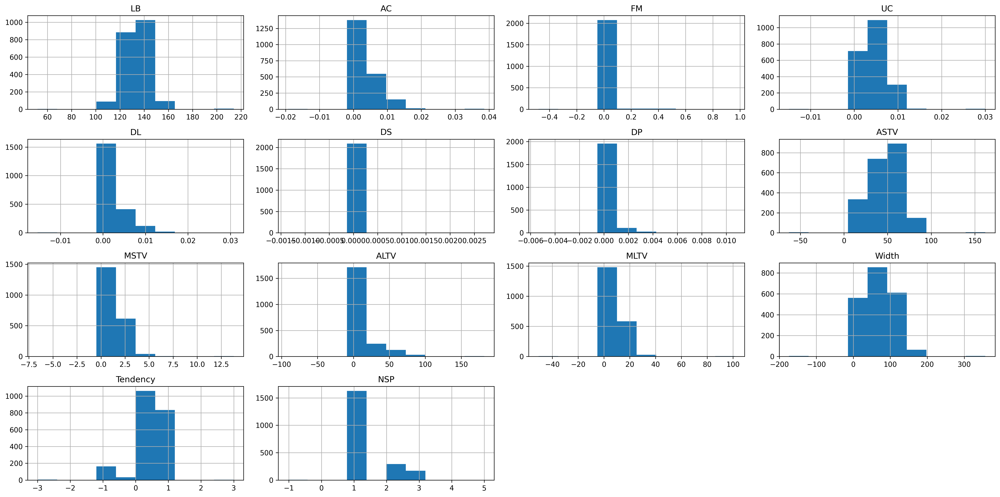

In [35]:
df.hist(figsize=(20,10))
plt.tight_layout()
# to determine the outliers and skewness of the dataset


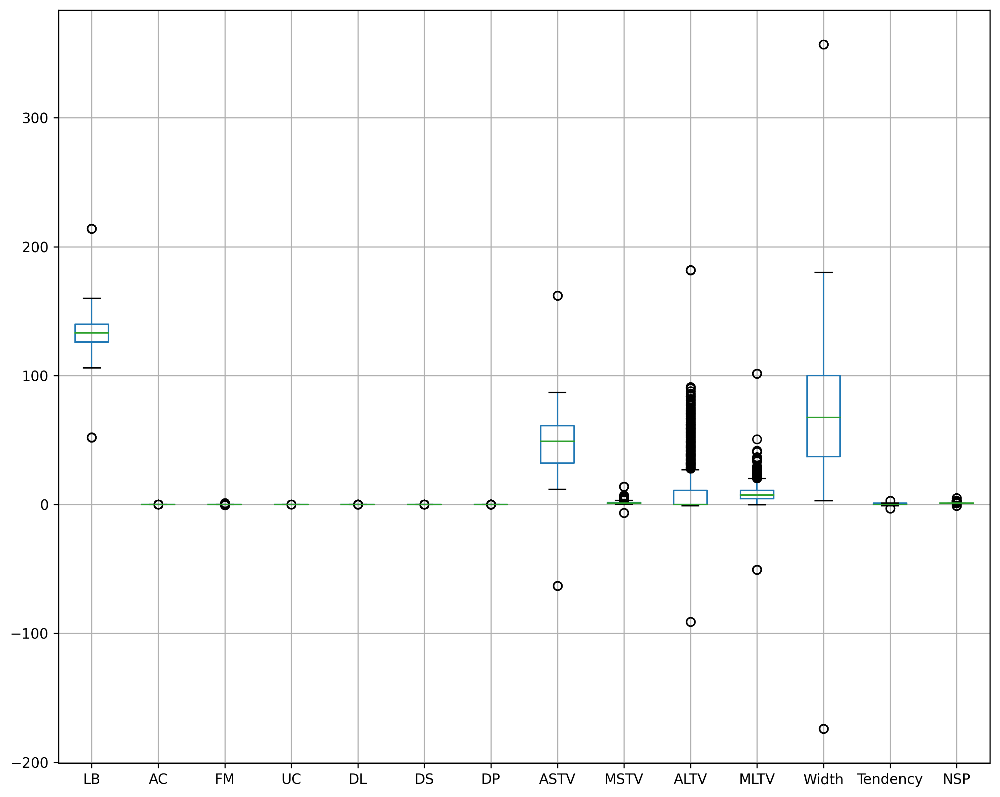

In [40]:
df.boxplot(figsize=(10,8))
plt.tight_layout()

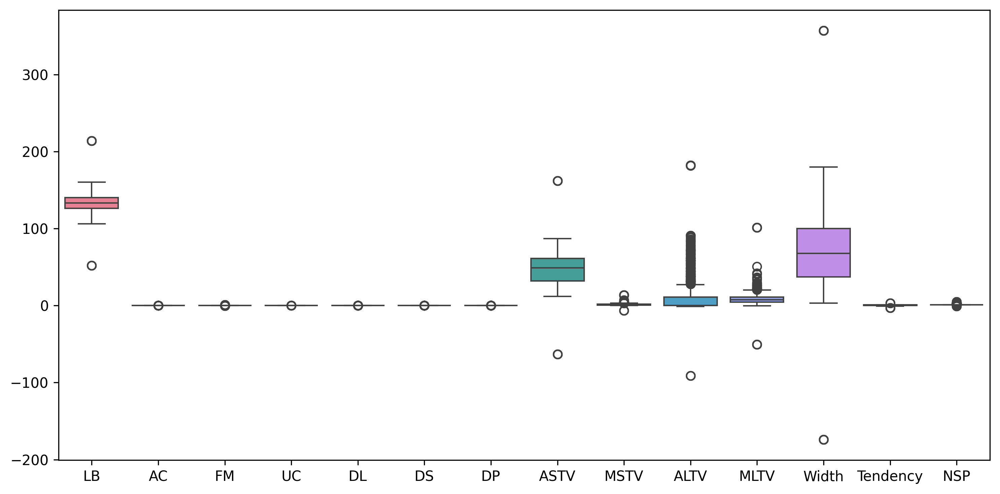

In [41]:
sns.boxplot(df)
plt.tight_layout()

<Axes: ylabel='LB'>

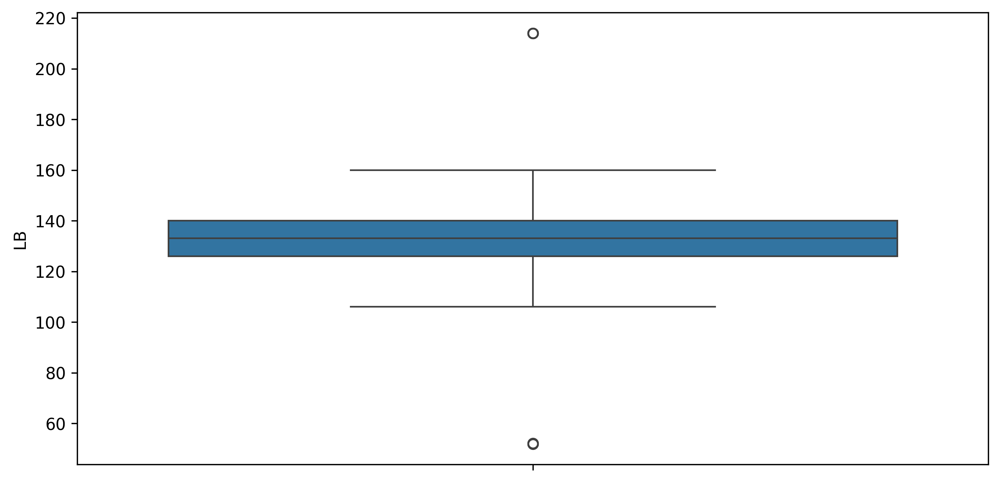

In [64]:
sns.boxplot(df['LB'])
# it has outliers

<Axes: ylabel='LB'>

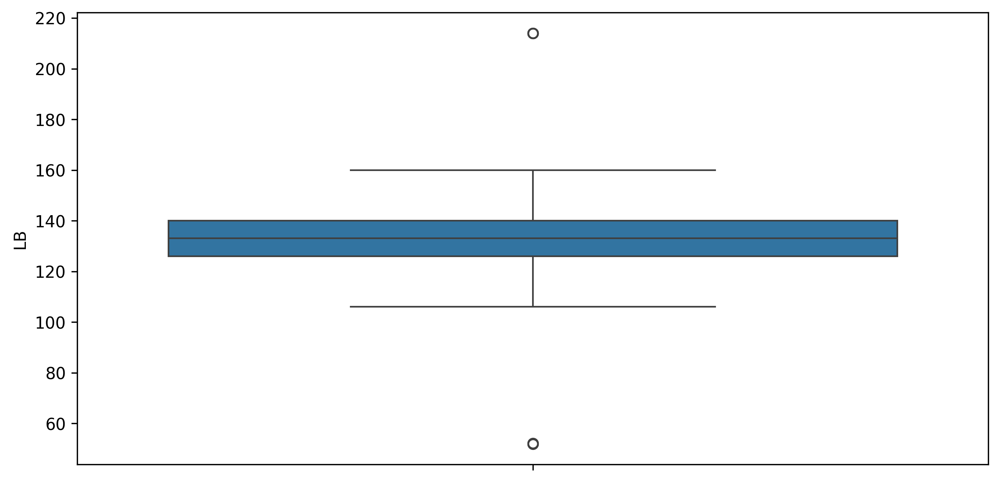

In [63]:
sns.boxplot(df['AC'])
# it has outliers

<Axes: ylabel='DS'>

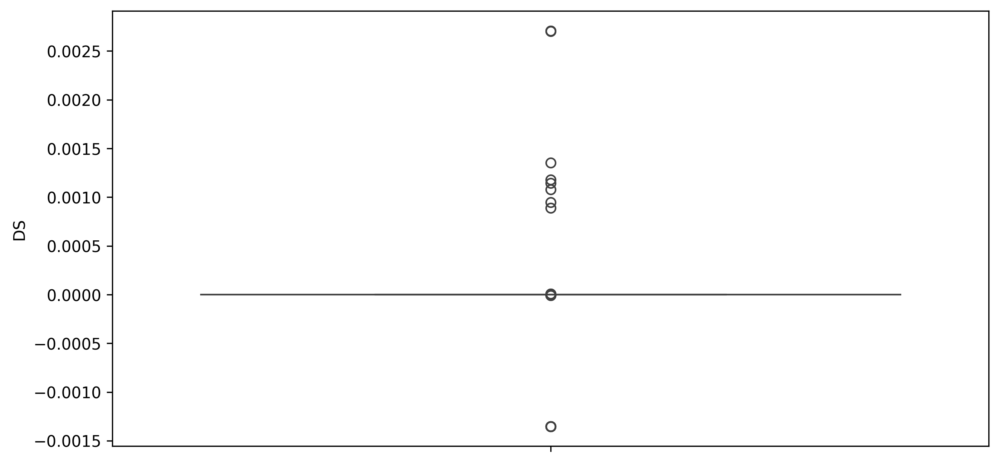

In [65]:
sns.boxplot(df['DS'])
# it has outliers

<Axes: ylabel='DP'>

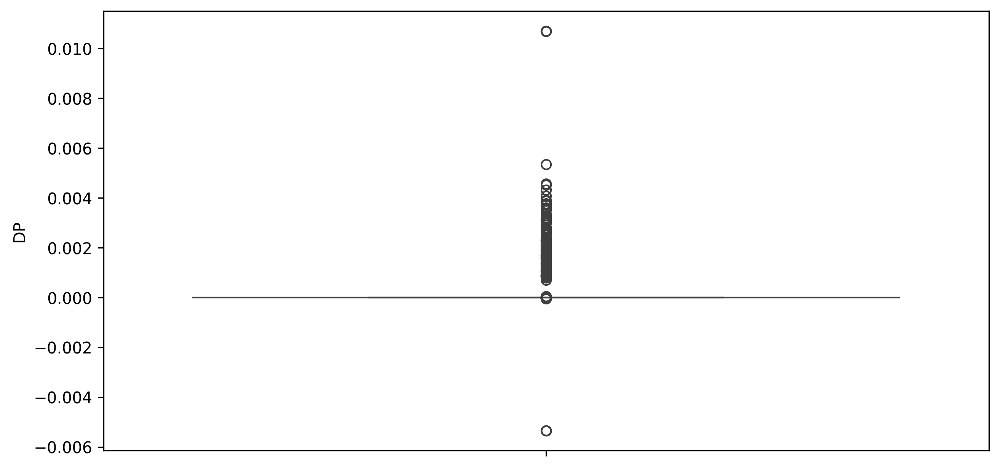

In [66]:
sns.boxplot(df['DP'])
# it has outliers


<Axes: ylabel='MLTV'>

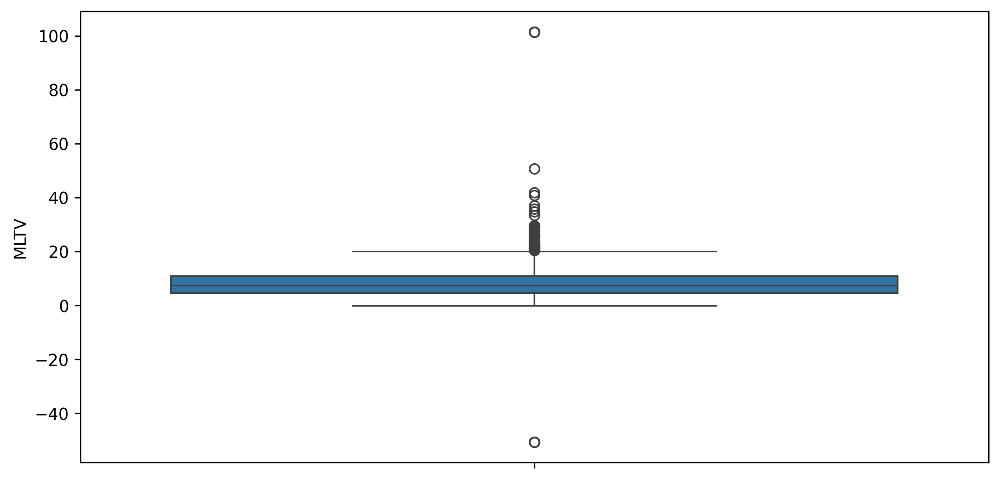

In [67]:
sns.boxplot(df['MLTV'])
# it has outliers

<Axes: ylabel='Width'>

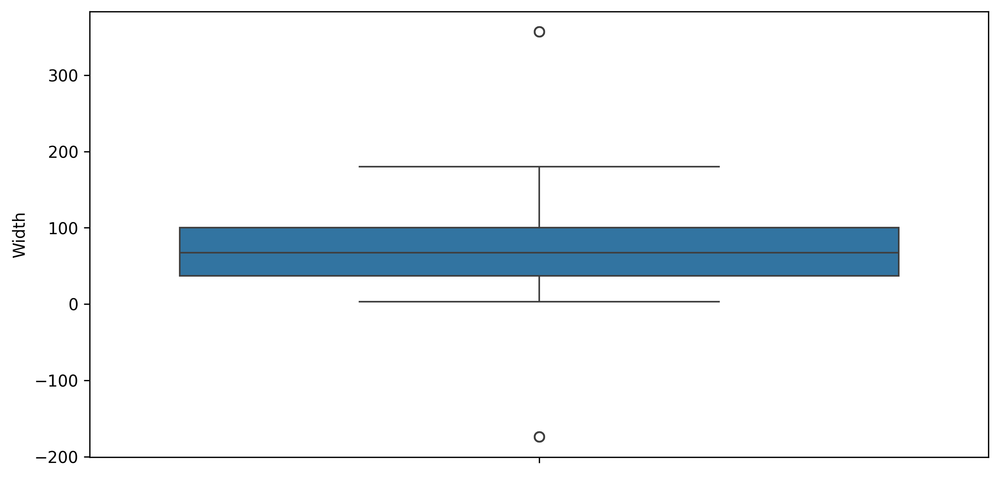

In [68]:
sns.boxplot(df['Width'])
# it has outliers

<Axes: ylabel='Tendency'>

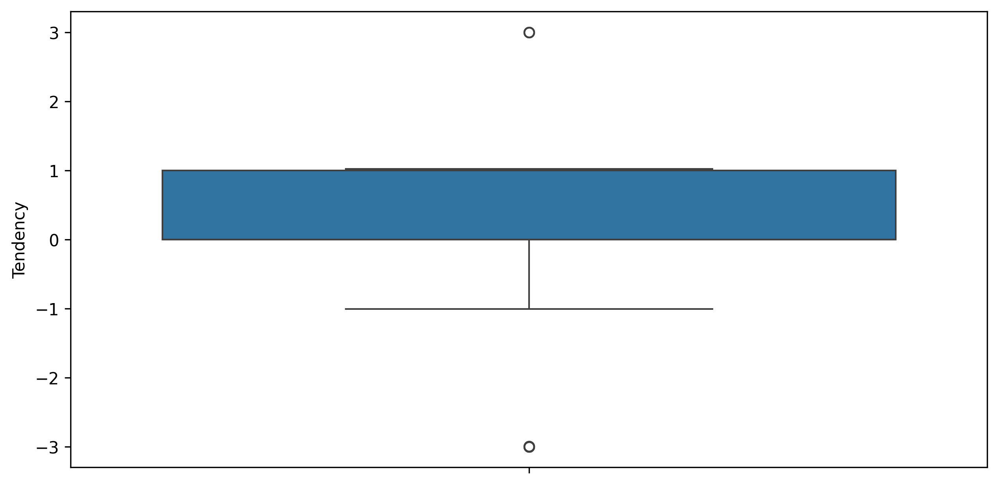

In [69]:
sns.boxplot(df['Tendency'])
# it has outliers

<Axes: ylabel='NSP'>

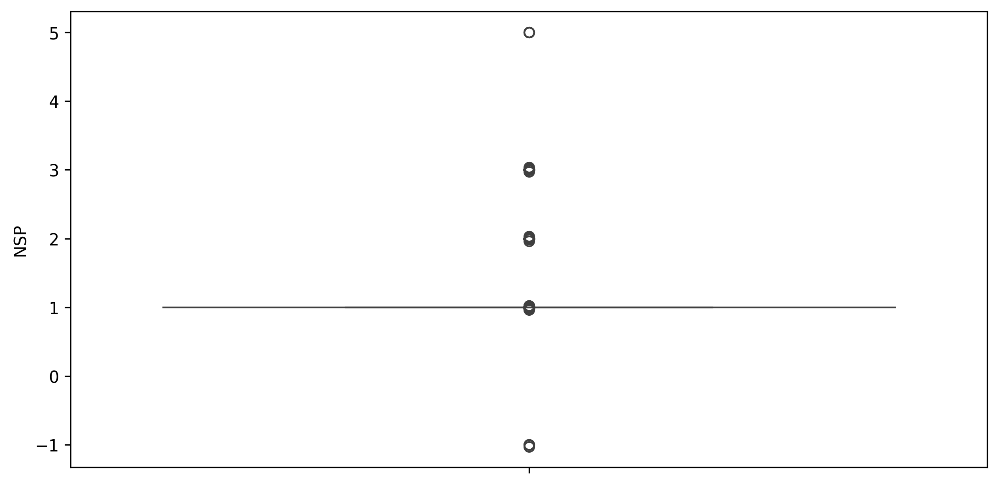

In [70]:
sns.boxplot(df['NSP'])
# it has outliers

In [77]:
# hence all the missing value columns are having outliers
# replace missing values by median
LB_median=df["LB"].median()
print(LB_median)

AC_median=df["AC"].median()
print(AC_median)

DS_median=df["DS"].median()
print(DS_median)

DP_median=df["DP"].median()
print(DP_median)

MLTV_median=df["MLTV"].median()
print(MLTV_median)

Width_median=df["Width"].median()
print(Width_median)

Tendency_median=df["Tendency"].median()
print(Tendency_median)

NSP_median=df["NSP"].median()
print(NSP_median)

133.0
0.001633991
0.0
0.0
7.4
67.48646809530248
0.0
1.0


In [80]:
df["LB"].fillna(LB_median,inplace=True)
df["AC"].fillna(AC_median,inplace=True)
df["DS"].fillna(DS_median,inplace=True)
df["DP"].fillna(DP_median,inplace=True)
df["MLTV"].fillna(MLTV_median,inplace=True)
df["Width"].fillna(Width_median,inplace=True)
df["Tendency"].fillna(Tendency_median,inplace=True)
df["NSP"].fillna(NSP_median,inplace=True)


In [81]:
df.isna().sum()

,0
LB,0
AC,0
FM,0
UC,0
DL,0
DS,0
DP,0
ASTV,0
MSTV,0
ALTV,0


Outliers detection


In [82]:
df.describe()

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,MLTV,Width,Tendency,NSP
count,2124.000000,2124.000000,2124.000000,2124.000000,2124.000000,2124.000000,2124.000000,2124.000000,2124.000000,2124.000000,2124.00000,2124.000000,2124.000000,2124.000000
mean,133.338641,0.003205,0.009904,0.004394,0.001897,0.000002,0.000174,47.012459,1.364345,10.295650,8.27184,70.431643,0.313541,1.301783
std,11.212447,0.004374,0.067571,0.003340,0.003344,0.000141,0.000836,18.812403,1.174084,21.212676,7.73691,42.727919,0.643417,0.642369
min,51.842487,-0.019284,-0.480634,-0.014925,-0.015393,-0.001353,-0.005348,-63.000000,-6.600000,-91.000000,-50.70000,-174.000000,-3.000000,-1.025988
25%,126.000000,0.000000,0.000000,0.001858,0.000000,0.000000,0.000000,32.000000,0.700000,0.000000,4.60000,37.000000,0.000000,1.000000
50%,133.000000,0.001634,0.000000,0.004486,0.000000,0.000000,0.000000,49.000000,1.200000,0.000000,7.40000,67.486468,0.000000,1.000000
75%,140.000000,0.005612,0.002568,0.006536,0.003292,0.000000,0.000000,61.000000,1.700000,11.000000,10.80000,100.000000,1.000000,1.000000
max,214.000000,0.038567,0.961268,0.030002,0.030769,0.002706,0.010695,162.000000,13.800000,182.000000,101.40000,357.000000,3.000000,5.000000


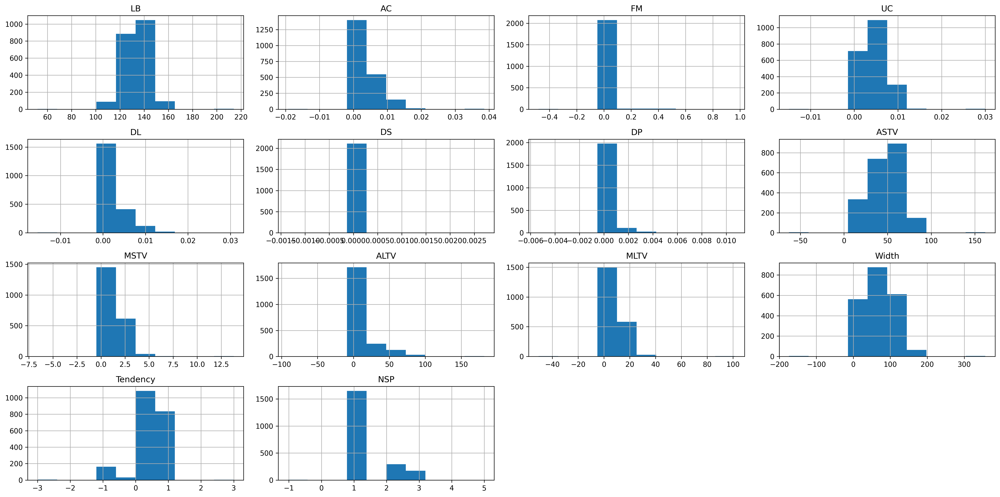

In [83]:
df.hist(figsize=(20,10))
plt.tight_layout()
# to determine the outliers and skewness of the dataset

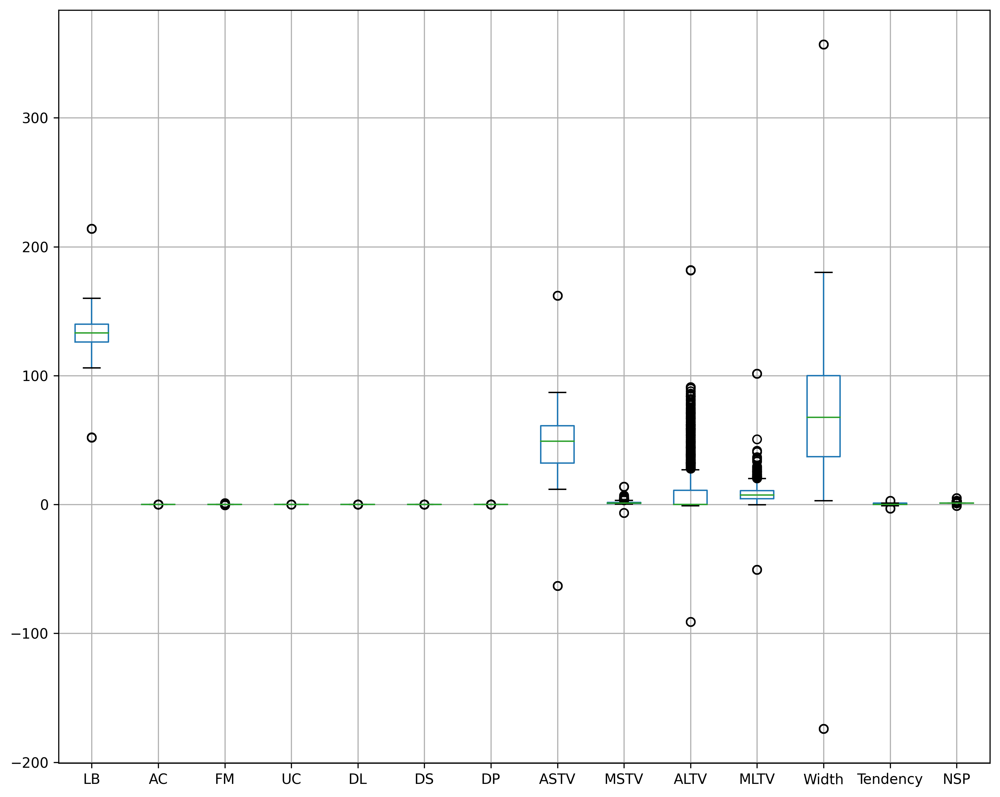

In [85]:
df.boxplot(figsize=(10,8))
plt.tight_layout()

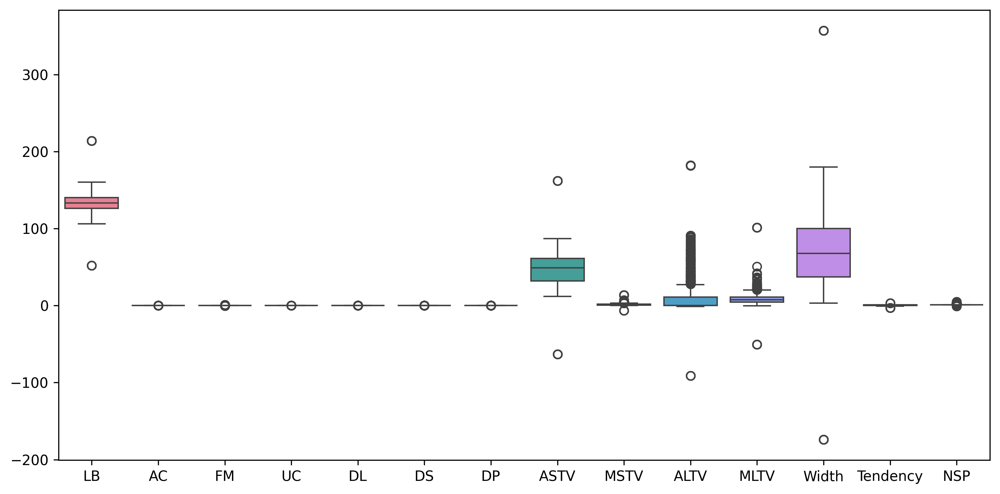

In [86]:
sns.boxplot(df)
plt.tight_layout()

<Axes: ylabel='LB'>

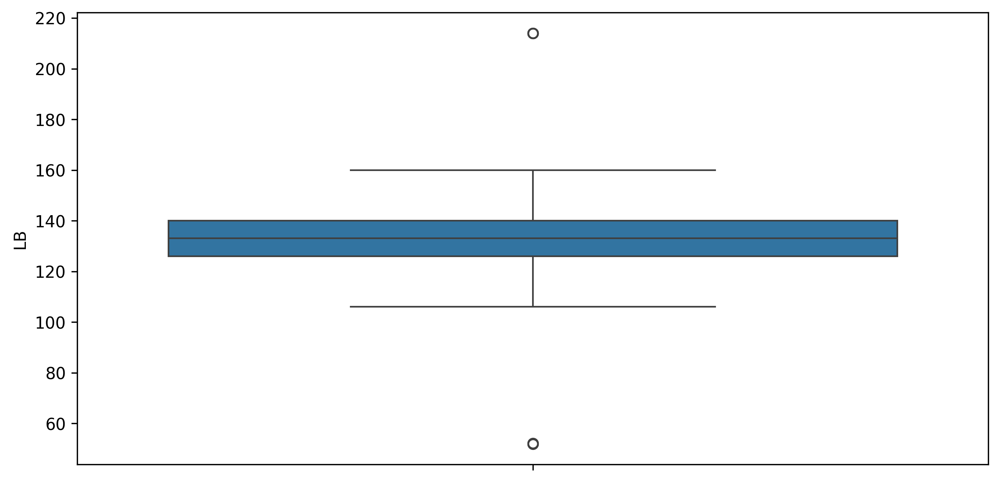

In [87]:
sns.boxplot(df['LB'])
# it has outliers

<Axes: ylabel='AC'>

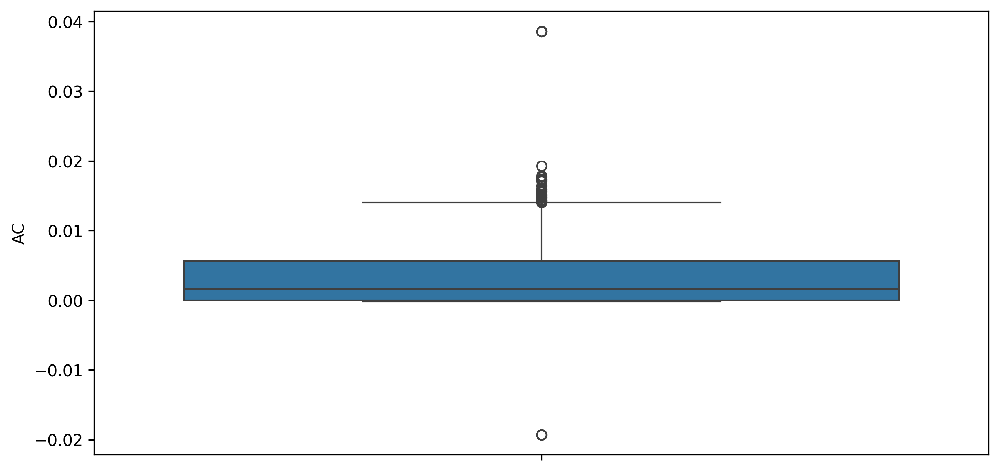

In [88]:
sns.boxplot(df['AC'])
# it has outliers

<Axes: ylabel='FM'>

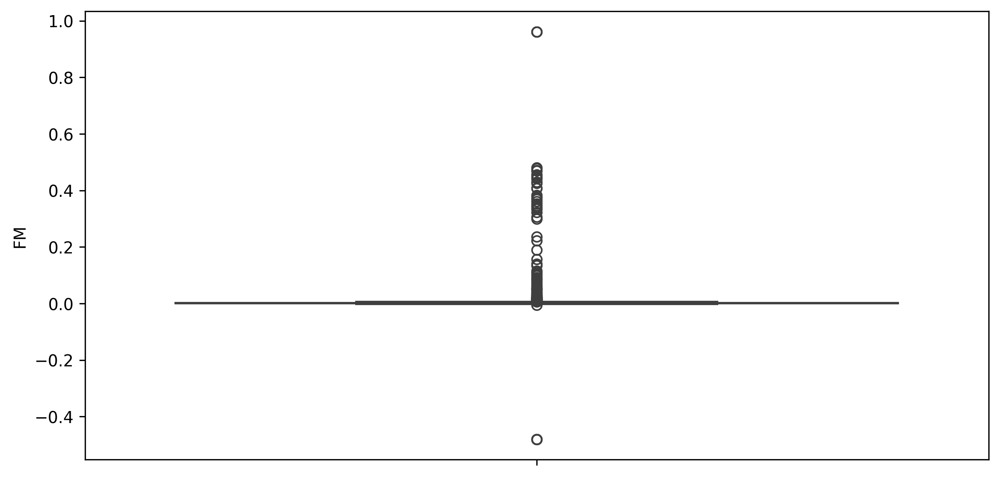

In [89]:
sns.boxplot(df['FM'])
# it has outliers

<Axes: ylabel='UC'>

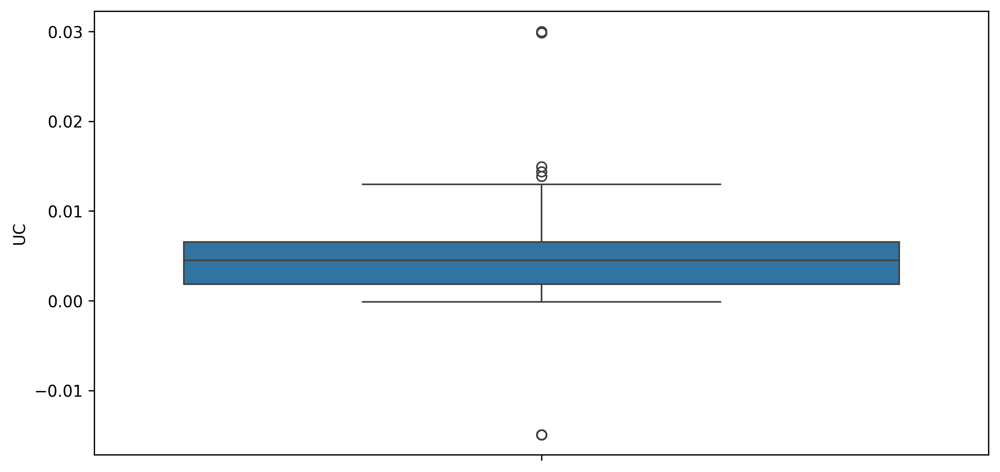

In [90]:
sns.boxplot(df['UC'])
# it has outliers

<Axes: ylabel='DL'>

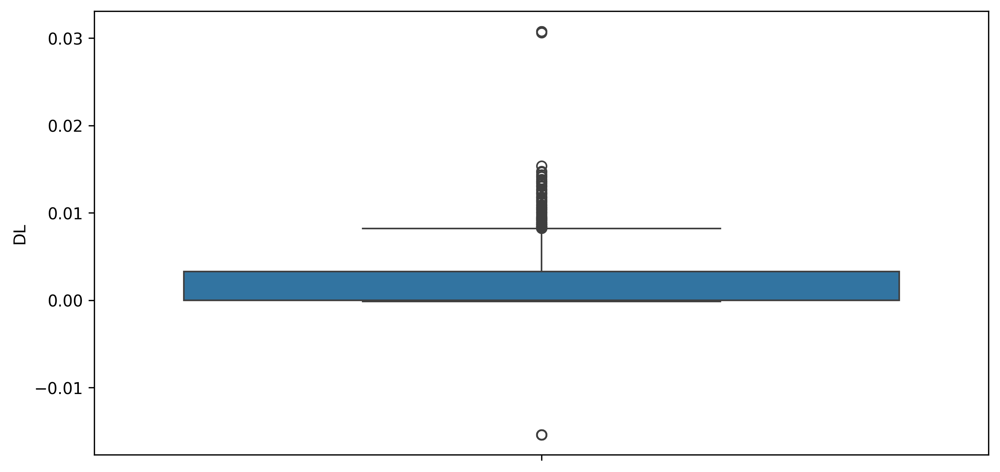

In [91]:
sns.boxplot(df['DL'])
# it has outliers

<Axes: ylabel='DS'>

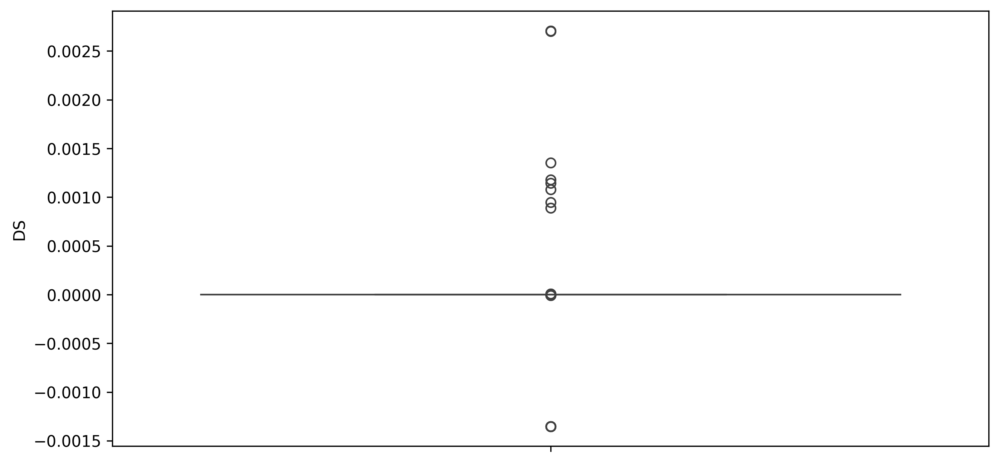

In [92]:
sns.boxplot(df['DS'])
# it has outliers

<Axes: ylabel='DP'>

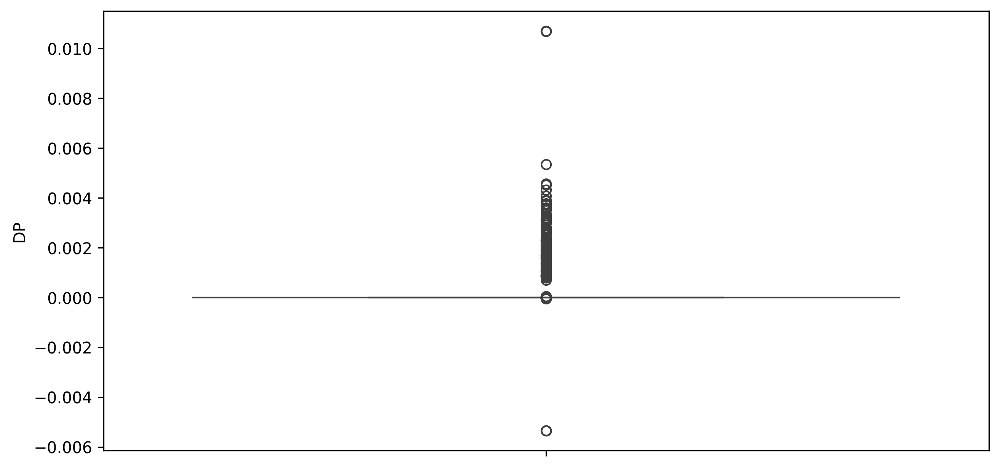

In [93]:
sns.boxplot(df['DP'])
# it has outliers


<Axes: ylabel='ASTV'>

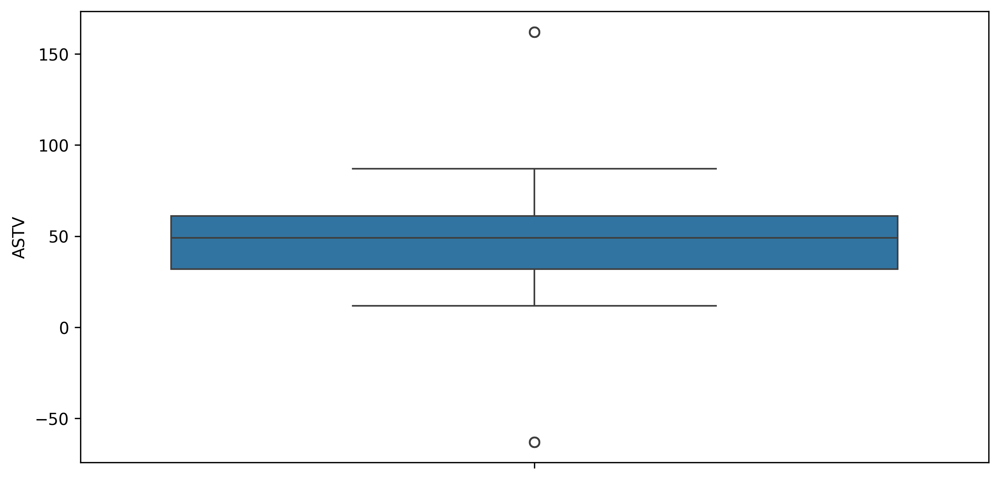

In [94]:
sns.boxplot(df['ASTV'])
# it has outliers

<Axes: ylabel='MSTV'>

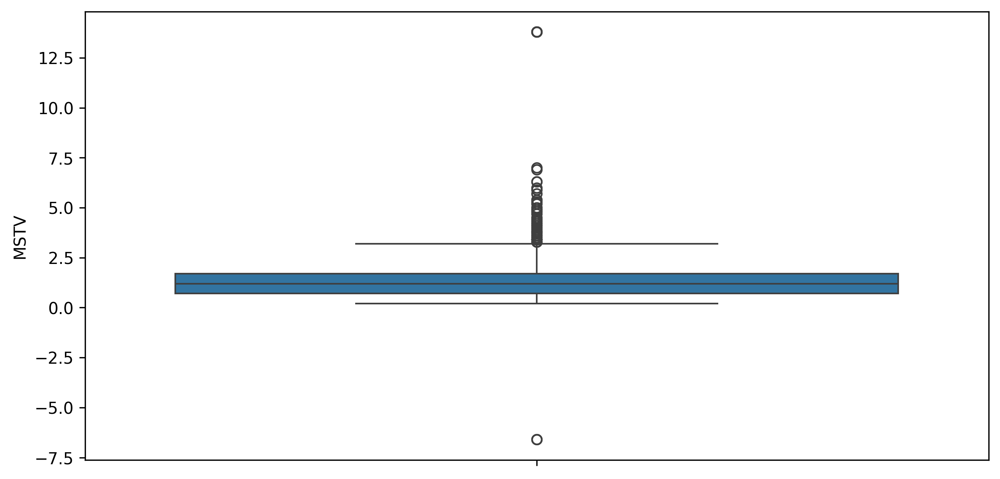

In [95]:
sns.boxplot(df['MSTV'])
# it has outliers

<Axes: ylabel='ALTV'>

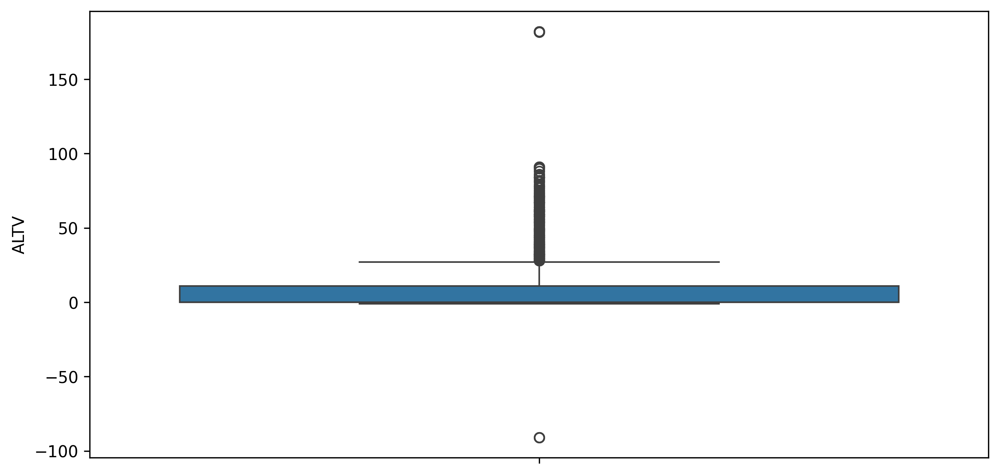

In [96]:
sns.boxplot(df['ALTV'])
# it has outliers

<Axes: ylabel='MLTV'>

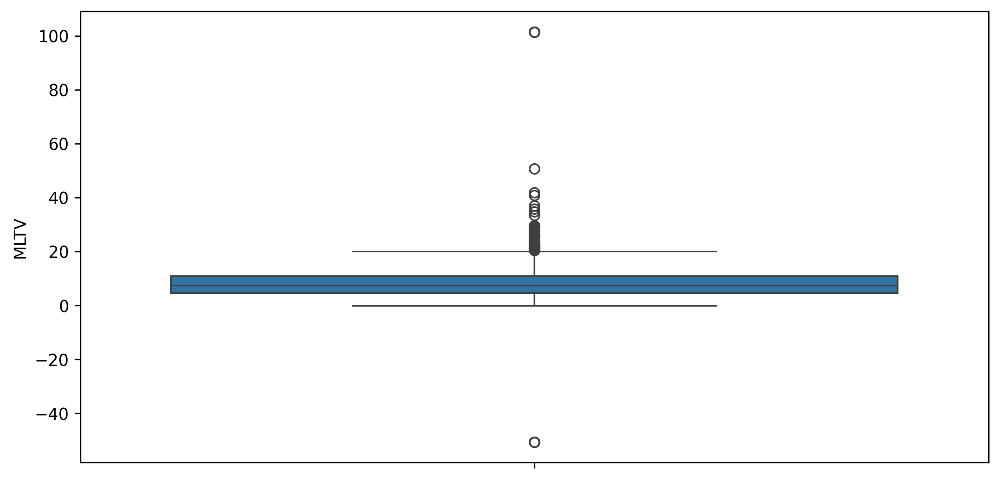

In [97]:
sns.boxplot(df['MLTV'])
# it has outliers

<Axes: ylabel='Width'>

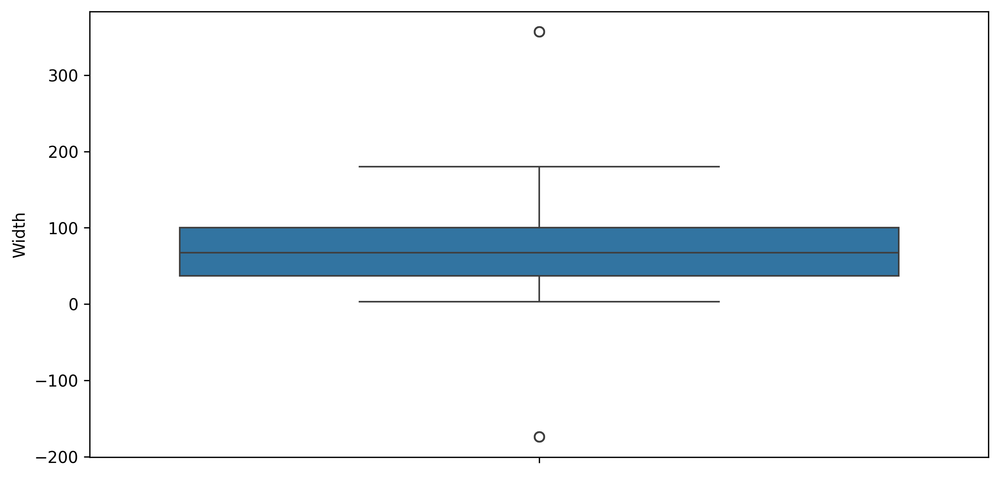

In [98]:
sns.boxplot(df['Width'])
# it has outliers

<Axes: ylabel='Tendency'>

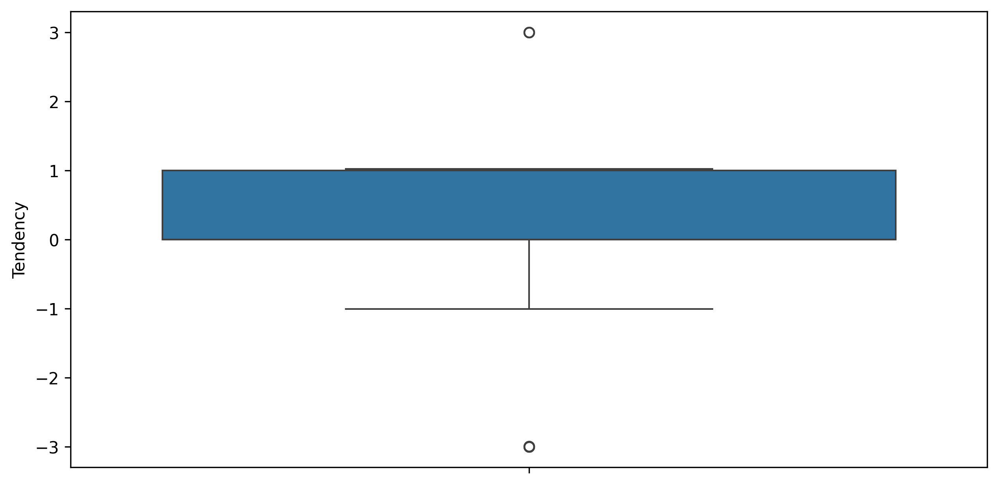

In [99]:
sns.boxplot(df['Tendency'])
# it has outliers

<Axes: ylabel='NSP'>

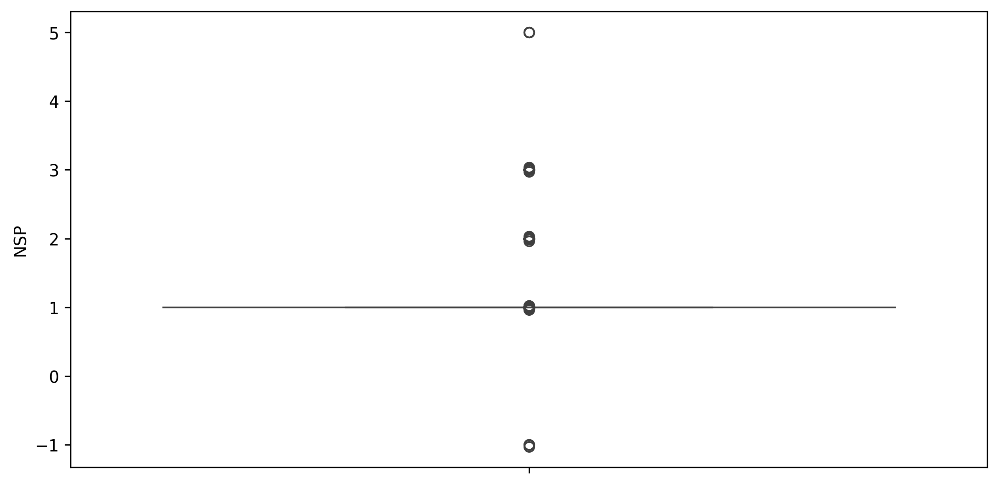

In [100]:
sns.boxplot(df['NSP'])
# it has outliers

In [103]:
def outlier_detection(data):
  q1=data.quantile(0.25)
  q2=data.quantile(0.75)

  iqr=q2-q1
  upper_extreame=q2+(1.5*iqr)
  lower_extreame=q1-(1.5*iqr)
  return lower_extreame,upper_extreame,q1,q2

In [104]:
outlier_detection(df)

(LB          105.000000
 AC           -0.008418
 FM           -0.003853
 UC           -0.005158
 DL           -0.004938
 DS            0.000000
 DP            0.000000
 ASTV        -11.500000
 MSTV         -0.800000
 ALTV        -16.500000
 MLTV         -4.700000
 Width       -57.500000
 Tendency     -1.500000
 NSP           1.000000
 dtype: float64,
 LB          161.000000
 AC            0.014030
 FM            0.006421
 UC            0.013552
 DL            0.008230
 DS            0.000000
 DP            0.000000
 ASTV        104.500000
 MSTV          3.200000
 ALTV         27.500000
 MLTV         20.100000
 Width       194.500000
 Tendency      2.500000
 NSP           1.000000
 dtype: float64,
 LB          126.000000
 AC            0.000000
 FM            0.000000
 UC            0.001858
 DL            0.000000
 DS            0.000000
 DP            0.000000
 ASTV         32.000000
 MSTV          0.700000
 ALTV          0.000000
 MLTV          4.600000
 Width        37.000000
 Tende

In [106]:
df[df['LB']>161.00]

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,MLTV,Width,Tendency,NSP
411,214.0,0.000000,0.000000,0.001595,0.001595,0.000000,0.0,71.000000,0.300000,17.0,5.8,15.0,0.0,2.0000
610,214.0,0.002469,0.002469,0.002469,0.000000,0.000004,0.0,35.000000,1.798149,0.0,24.7,118.0,1.0,1.0000
612,214.0,0.005181,0.012953,0.002591,0.000000,0.000000,0.0,39.442226,1.600000,0.0,10.0,136.0,0.0,0.9912
1103,214.0,0.006972,0.000000,0.002960,0.000000,0.000000,0.0,19.000000,2.300000,0.0,12.1,53.0,0.0,1.0000
1406,214.0,0.005068,0.000000,0.001689,0.000000,0.000000,0.0,46.000000,0.800000,0.0,8.6,67.0,1.0,1.0000
1504,214.0,0.006189,0.000000,0.006189,0.000000,0.000000,0.0,38.000000,1.000000,0.0,8.1,53.0,0.0,1.0000


In [107]:
df[df['LB']>161.00].shape

(6, 14)

In [109]:
df.loc[df['LB']>161.00,'LB']

,LB
411,214.0
610,214.0
612,214.0
1103,214.0
1406,214.0
1504,214.0


In [110]:
df.loc[df['LB']>161.00,'LB']=161.00

In [111]:
df[df['LB']>161.00]

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,MLTV,Width,Tendency,NSP


In [112]:
df[df['LB']==161.00]

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,MLTV,Width,Tendency,NSP
411,161.0,0.000000,0.000000,0.001595,0.001595,0.000000,0.0,71.000000,0.300000,17.0,5.8,15.0,0.0,2.0000
610,161.0,0.002469,0.002469,0.002469,0.000000,0.000004,0.0,35.000000,1.798149,0.0,24.7,118.0,1.0,1.0000
612,161.0,0.005181,0.012953,0.002591,0.000000,0.000000,0.0,39.442226,1.600000,0.0,10.0,136.0,0.0,0.9912
1103,161.0,0.006972,0.000000,0.002960,0.000000,0.000000,0.0,19.000000,2.300000,0.0,12.1,53.0,0.0,1.0000
1406,161.0,0.005068,0.000000,0.001689,0.000000,0.000000,0.0,46.000000,0.800000,0.0,8.6,67.0,1.0,1.0000
1504,161.0,0.006189,0.000000,0.006189,0.000000,0.000000,0.0,38.000000,1.000000,0.0,8.1,53.0,0.0,1.0000


In [113]:
df.loc[df['LB']<105.00,'LB']

,LB
134,52.000000
785,52.000000
1027,51.842487
1834,52.188547


In [115]:
df.loc[df['LB']<105.00,'LB']=105.00

In [116]:
df.loc[df['AC']>0.014030,'AC']=0.014030

In [117]:
df.loc[df['AC']<-0.008418,'AC']=-0.008418

In [118]:
df.loc[df['FM']>0.006421,'FM']=0.006421

In [119]:
df.loc[df['FM']<-0.003853,'FM']=-0.003853

In [120]:
df.loc[df['UC']>0.013552,'UC']=0.013552

In [121]:
df.loc[df['UC']<-0.005158,'UC']=-0.005158

In [122]:
df.loc[df['DL']>0.008230,'DL']=0.008230

In [123]:
df.loc[df['DL']<-0.004938,'DL']=-0.004938

In [124]:
df.loc[df['DS']>00,'DS']=00

In [125]:
df.loc[df['DS']<0.000000,'DS']=0.000000

In [126]:
df.loc[df['DP']>00,'DP']=00

In [127]:
df.loc[df['DP']<00,'DP']=00

In [128]:
df.loc[df['ASTV']>104.500000,'ASTV']=104.500000

In [129]:
df.loc[df['ASTV']< -11.500000,'ASTV']= -11.500000

In [130]:
df.loc[df['MSTV']>3.200000,'MSTV']=3.200000

In [131]:
df.loc[df['MSTV']<-0.800000,'MSTV']=-0.800000

In [132]:
df.loc[df['ALTV']>27.500000,'ALTV']=27.500000

In [133]:
df.loc[df['ALTV']<-16.500000,'TV']=-16.500000

In [134]:
df.loc[df['MLTV']>20.100000,'MLTV']=20.100000

In [135]:
df.loc[df['MLTV']<-4.700000,'MLTV']=-4.700000

In [136]:
df.loc[df['Width']>194.500000,'Width']=194.500000

In [137]:
df.loc[df['Width']<-57.500000,'Width']=-57.500000

In [138]:
df.loc[df['Tendency']>2.5,'Tendency']=2.5

In [139]:
df.loc[df['Tendency']<-1.500000,'Tendency']=-1.500000

In [140]:
df.loc[df['NSP']>1,'NSP']=1

In [141]:
df.loc[df['NSP']<1,'NSP']=1

# **Statistical Summary**

In [142]:
df.describe()
# missing values are treated(no missing values)
# no outliers


,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,MLTV,Width,Tendency,NSP,TV
count,2124.000000,2124.000000,2124.000000,2124.000000,2124.000000,2124.0,2124.0,2124.000000,2124.000000,2124.000000,2124.000000,2124.000000,2124.000000,2124.0,3.0
mean,133.288721,0.003133,0.001570,0.004365,0.001772,0.0,0.0,46.998334,1.304554,6.592753,8.002912,70.323356,0.316835,1.0,-16.5
std,9.926790,0.003830,0.002487,0.003000,0.002670,0.0,0.0,17.609911,0.781303,10.976645,5.046792,39.577011,0.622623,0.0,0.0
min,105.000000,-0.008418,-0.003853,-0.005158,-0.004938,0.0,0.0,-11.500000,-0.800000,-91.000000,-4.700000,-57.500000,-1.500000,1.0,-16.5
25%,126.000000,0.000000,0.000000,0.001858,0.000000,0.0,0.0,32.000000,0.700000,0.000000,4.600000,37.000000,0.000000,1.0,-16.5
50%,133.000000,0.001634,0.000000,0.004486,0.000000,0.0,0.0,49.000000,1.200000,0.000000,7.400000,67.486468,0.000000,1.0,-16.5
75%,140.000000,0.005612,0.002568,0.006536,0.003292,0.0,0.0,61.000000,1.700000,11.000000,10.800000,100.000000,1.000000,1.0,-16.5
max,161.000000,0.014030,0.006421,0.013552,0.008230,0.0,0.0,104.500000,3.200000,27.500000,20.100000,194.500000,2.500000,1.0,-16.5


# **Data Visualization**

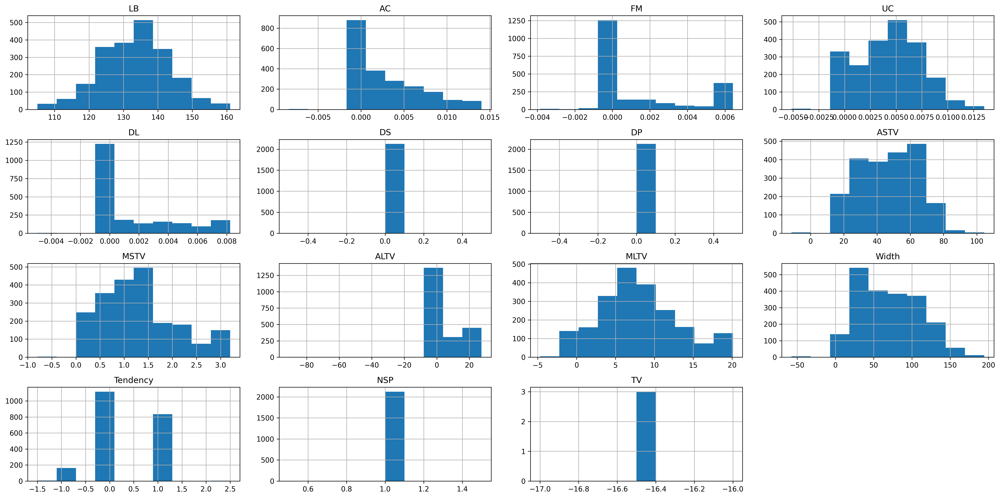

In [143]:
df.hist(figsize=(20,10))
plt.tight_layout()

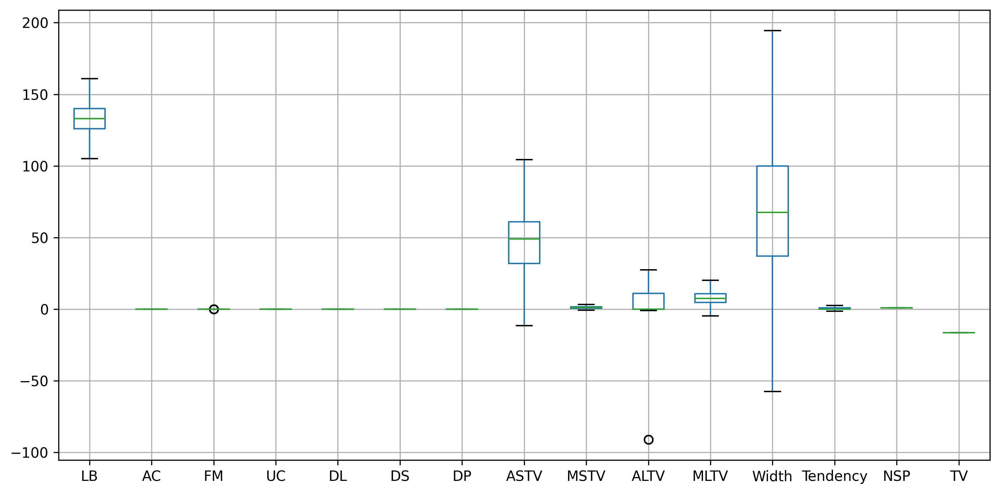

In [145]:
df.boxplot()
plt.tight_layout()

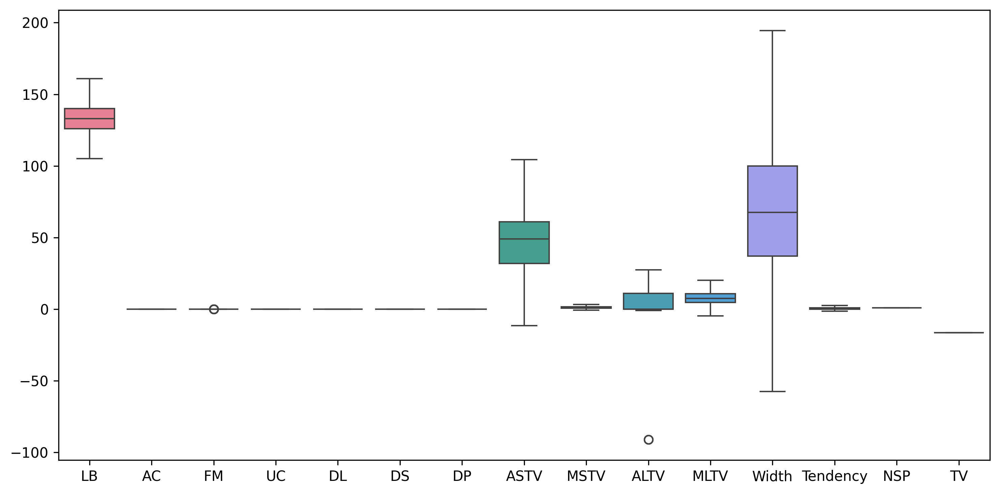

In [146]:
sns.boxplot(df)
plt.tight_layout()


In [147]:
sns.pairplot(df)

<Axes: >

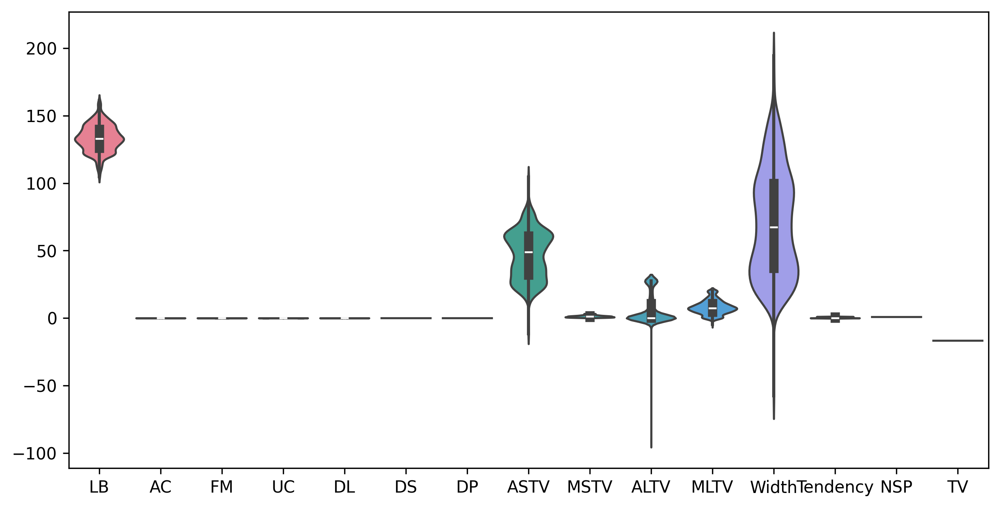

In [148]:
sns.violinplot(df)

# **Pattren Recognition and Insights**

In [149]:
sns.pairplot(df)

In [150]:
df.corr()

,LB,AC,FM,UC,DL,DS,DP,ASTV,MSTV,ALTV,MLTV,Width,Tendency,NSP,TV
LB,1.000000,-0.081548,-0.006840,-0.163345,-0.156314,NaN,NaN,0.285464,-0.295132,0.304822,-0.042241,-0.139983,0.281144,NaN,NaN
AC,-0.081548,1.000000,0.075611,0.093222,-0.103255,NaN,NaN,-0.273189,0.216861,-0.388588,-0.151712,0.283725,0.030489,NaN,NaN
FM,-0.006840,0.075611,1.000000,-0.318156,-0.018024,NaN,NaN,0.155798,0.070412,-0.007015,-0.036439,0.164189,0.000302,NaN,NaN
UC,-0.163345,0.093222,-0.318156,1.000000,0.268154,NaN,NaN,-0.217484,0.298462,-0.279213,-0.073152,0.131025,-0.074729,NaN,NaN
DL,-0.156314,-0.103255,-0.018024,0.268154,1.000000,NaN,NaN,-0.112292,0.566627,-0.275059,-0.242342,0.514259,0.014030,NaN,NaN
DS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
DP,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ASTV,0.285464,-0.273189,0.155798,-0.217484,-0.112292,NaN,NaN,1.000000,-0.433731,0.419355,-0.323930,-0.242114,-0.010237,NaN,NaN
MSTV,-0.295132,0.216861,0.070412,0.298462,0.566627,NaN,NaN,-0.433731,1.000000,-0.510652,0.010734,0.646202,-0.064696,NaN,NaN
ALTV,0.304822,-0.388588,-0.007015,-0.279213,-0.275059,NaN,NaN,0.419355,-0.510652,1.000000,-0.128871,-0.411524,0.049118,NaN,NaN


<Axes: >

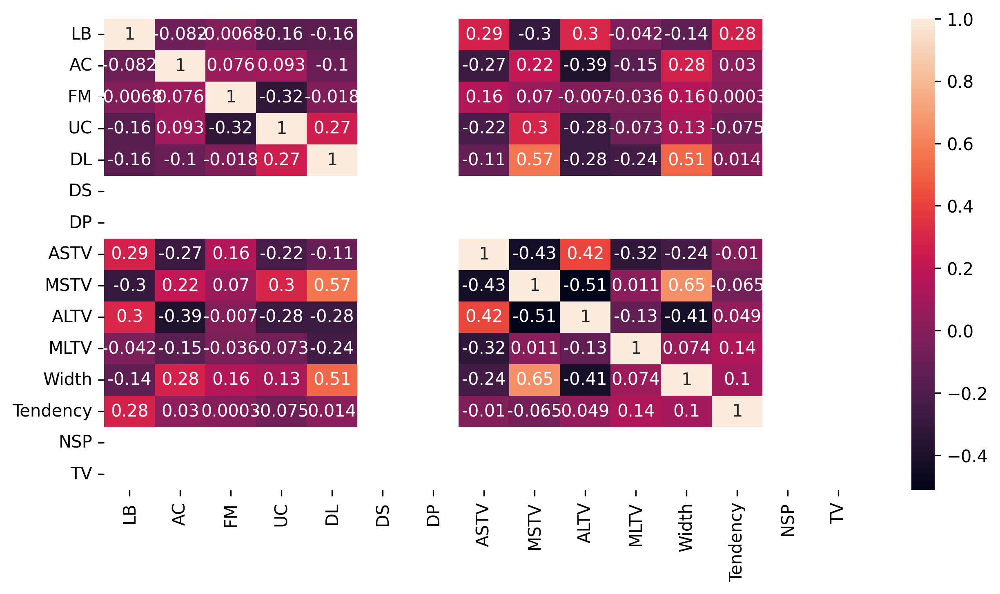

In [152]:
sns.heatmap(df.corr(),annot=True)

<Axes: >

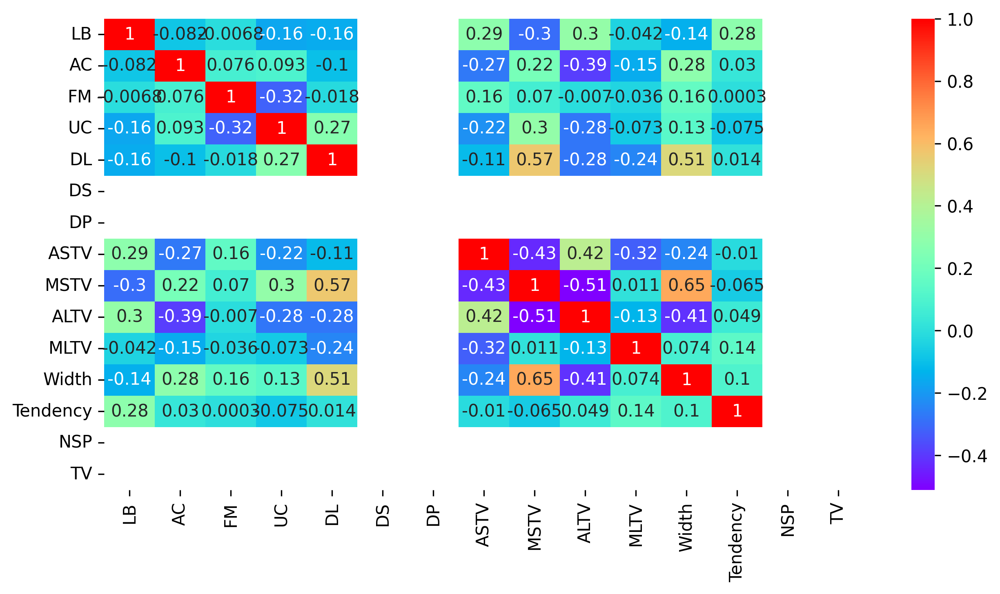

In [153]:
sns.heatmap(df.corr(),annot=True,cmap="rainbow")